# Natural Language Processing



This notebook covers a handful of the NLP building blocks provided by Natural Language Toolkit for Python (NLTK), including stemming & lemmatization, frequency analysis, named entity recognition, and text classification. Several of these components will then be assembled to build a very basic document summarisation program.

Install NLTK

In [ ]:
# !pip install nltk

Importing and downloading NLTK resources

In [ ]:
import nltk

The first time you run anything using NLTK, you'll want to go ahead and download the additional resources that aren't distributed directly with the NLTK package. Upon running the nltk.download() command below, the the NLTK Downloader window will pop-up. In the Collections tab, select "all" and click on Download. As mentioned earlier, this may take several minutes depending on your network connection speed, but you'll only ever need to run it a single time.

In [ ]:
# nltk.download()

NLTK Downloader
---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> h

Commands:
  d) Download a package or collection     u) Update out of date packages
  l) List packages & collections          h) Help
  c) View & Modify Configuration          q) Quit

---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> d

Download which package (l=list; x=cancel)?
  Identifier> all


       | 
       | Downloading package abc to /root/nltk_data...
       |   Unzipping corpora/abc.zip.
       | Downloading package alpino to /root/nltk_data...
       |   Unzipping corpora/alpino.zip.
       | Downloading package averaged_perceptron_tagger to
       |     /root/nltk_data...
       |   Unzipping taggers/averaged_perceptron_tagger.zip.
       | Downloading package averaged_perceptron_tagger_ru to
       |     /root/nltk_data...
       |   Unzipping taggers/averaged_perceptron_tagger_ru.zip.
       | Downloading package basque_grammars to /root/nltk_data...
       |   Unzipping grammars/basque_grammars.zip.
       | Downloading package bcp47 to /root/nltk_data...
       | Downloading package biocreative_ppi to /root/nltk_data...
       |   Unzipping corpora/biocreative_ppi.zip.
       | Downloading package bllip_wsj_no_aux to /root/nltk_data...
       |   Unzipping models/bllip_wsj_no_aux.zip.
       | Downloading package book_grammars to /root/nltk_data...
       |   Un


---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> q


True

### Tokenization
Process of breaking a text into individual words or tokens. NLTK provides a word_tokenize function that performs this task.

In [ ]:
from nltk.tokenize import word_tokenize

text = "Tesla shareholders have backed a record-breaking pay package for boss Elon Musk and approved a plan to move \
        the firm's legal headquarters to Texas."
tokens = word_tokenize(text)
print(tokens)

['Tesla', 'shareholders', 'have', 'backed', 'a', 'record-breaking', 'pay', 'package', 'for', 'boss', 'Elon', 'Musk', 'and', 'approved', 'a', 'plan', 'to', 'move', 'the', 'firm', "'s", 'legal', 'headquarters', 'to', 'Texas', '.']


### Stopword Removal

NLTK provides a stopwords module that contains a list of stop words for various languages. We can use this module to remove stop words from our tokens.

In [ ]:
from nltk.corpus import stopwords

stop_words = set(stopwords.words('english'))
filtered_tokens = [word for word in tokens if word.lower() not in stop_words]

print(filtered_tokens)

['Tesla', 'shareholders', 'backed', 'record-breaking', 'pay', 'package', 'boss', 'Elon', 'Musk', 'approved', 'plan', 'move', 'firm', "'s", 'legal', 'headquarters', 'Texas', '.']


### Lemmatization

NLTK provides a WordNetLemmatizer class that performs lemmatization.

In [ ]:
from nltk.stem import WordNetLemmatizer

lemmatizer = WordNetLemmatizer()
lemmatized_tokens = [lemmatizer.lemmatize(token) for token in filtered_tokens]

print(lemmatized_tokens)

['Tesla', 'shareholder', 'backed', 'record-breaking', 'pay', 'package', 'bos', 'Elon', 'Musk', 'approved', 'plan', 'move', 'firm', "'s", 'legal', 'headquarters', 'Texas', '.']


### Sentiment Analysis

NLTK provides a SentimentIntensityAnalyzer class that analyzes text for its negative, neutral, and positive sentiment.


In [ ]:
from nltk.sentiment import SentimentIntensityAnalyzer

analyzer = SentimentIntensityAnalyzer()

sentiment_scores = analyzer.polarity_scores(text)
print(sentiment_scores)

{'neg': 0.056, 'neu': 0.726, 'pos': 0.218, 'compound': 0.4588}


### Part-of-Speech Tagging

This example demonstrates how to tag each word in a sentence with its respective part of speech.

In [ ]:
from nltk import pos_tag

text = "Tesla shareholders have backed a record-breaking pay package for boss Elon Musk and approved a plan to move the firm's legal headquarters to Texas."
tokens = word_tokenize(text)
pos_tags = pos_tag(tokens)
print(pos_tags)


[('Tesla', 'NNP'), ('shareholders', 'NNS'), ('have', 'VBP'), ('backed', 'VBN'), ('a', 'DT'), ('record-breaking', 'JJ'), ('pay', 'NN'), ('package', 'NN'), ('for', 'IN'), ('boss', 'NN'), ('Elon', 'NNP'), ('Musk', 'NNP'), ('and', 'CC'), ('approved', 'VBD'), ('a', 'DT'), ('plan', 'NN'), ('to', 'TO'), ('move', 'VB'), ('the', 'DT'), ('firm', 'NN'), ("'s", 'POS'), ('legal', 'JJ'), ('headquarters', 'NN'), ('to', 'TO'), ('Texas', 'NNP'), ('.', '.')]


We will use spaCy to access additional attributes (such as TAG, Explain, DEP, Shape, etc.) to create an informative DataFrame.

In [ ]:
import spacy
import pandas as pd

# Loading the English language trained model
nlp = spacy.load("en_core_web_sm")

doc = nlp(text)
# for token in doc:
pos = [(token.text, token.lemma_, token.pos_, token.tag_, spacy.explain(token.tag_), token.dep_,
            token.shape_, token.is_alpha, token.is_stop) for token in doc]
df = pd.DataFrame(pos, columns=['Text', 'Lemma', 'POS', 'TAG', 'Explain', 'DEP', 'Shape', 'Alpha', 'Stop'])
df

,Text,Lemma,POS,TAG,Explain,DEP,Shape,Alpha,Stop
0,Tesla,Tesla,PROPN,NNP,"noun, proper singular",compound,Xxxxx,True,False
1,shareholders,shareholder,NOUN,NNS,"noun, plural",nsubj,xxxx,True,False
2,have,have,AUX,VBP,"verb, non-3rd person singular present",aux,xxxx,True,True
3,backed,back,VERB,VBN,"verb, past participle",ROOT,xxxx,True,False
4,a,a,DET,DT,determiner,det,x,True,True
5,record,record,NOUN,NN,"noun, singular or mass",npadvmod,xxxx,True,False
6,-,-,PUNCT,HYPH,"punctuation mark, hyphen",punct,-,False,False
7,breaking,break,VERB,VBG,"verb, gerund or present participle",amod,xxxx,True,False
8,pay,pay,NOUN,NN,"noun, singular or mass",compound,xxx,True,False
9,package,package,NOUN,NN,"noun, singular or mass",dobj,xxxx,True,False


### Named Entity Recognition

NLTK provides a ne_chunk function that performs NER.

In [ ]:
from nltk import ne_chunk

tokens = word_tokenize(text)

stop_words = set(stopwords.words('english'))
filtered_tokens = [word for word in tokens if word.lower() not in stop_words]

lemmatizer = WordNetLemmatizer()
lemmatized_tokens = [lemmatizer.lemmatize(token) for token in filtered_tokens]

pos_tags = nltk.pos_tag(lemmatized_tokens)

ner_tags = ne_chunk(pos_tags)
print(ner_tags)

(S
  (GPE Tesla/NNP)
  shareholder/NN
  backed/VBD
  record-breaking/JJ
  pay/NN
  package/NN
  bos/NN
  (PERSON Elon/NNP Musk/NNP)
  approved/VBD
  plan/NN
  move/VBP
  firm/NN
  's/POS
  legal/JJ
  headquarters/NN
  (PERSON Texas/NNP)
  ./.)


### Word Frequency Distribution

We can analyse the frequency of words in the text.

In [ ]:
from nltk.probability import FreqDist

fdist = FreqDist(lemmatized_tokens)
print(fdist.most_common(10))

[('Tesla', 1), ('shareholder', 1), ('backed', 1), ('record-breaking', 1), ('pay', 1), ('package', 1), ('bos', 1), ('Elon', 1), ('Musk', 1), ('approved', 1)]


We can visualise this distribution.

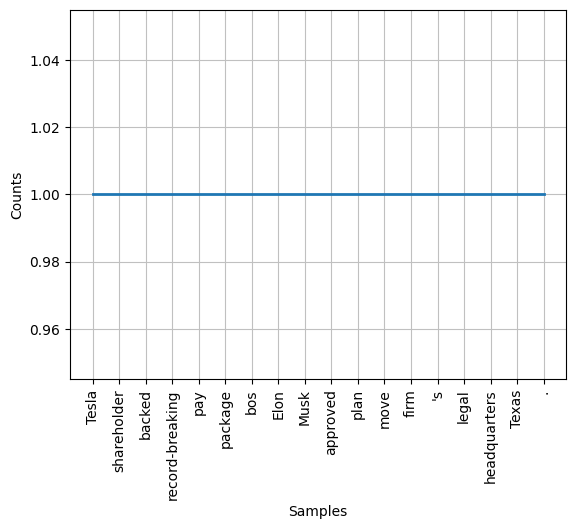

<Axes: xlabel='Samples', ylabel='Counts'>

In [ ]:
import matplotlib.pyplot as plt

fdist.plot(30, cumulative=False)

# Text Classification - Naive Bayes

In this example, we will go over a simple text classification using ```nltk```. We will use ```NaiveBayesClassifier``` which is a probabilistic classifier that applies Bayes' theorem with the assumption that features (words) are independent given the class. It calculates the probability of a text belonging to a particular class and chooses the class with the highest probability. Despite its simplicity, it performs well on various text classification tasks.



In [ ]:
from nltk.classify import NaiveBayesClassifier
from nltk.corpus import movie_reviews

nltk.download('movie_reviews')

[nltk_data] Downloading package movie_reviews to /root/nltk_data...
[nltk_data]   Package movie_reviews is already up-to-date!


True

Displaying some contents of movie_reviews to understand its structure.

In [ ]:
# Print statements to display contents
print("Categories:", movie_reviews.categories())
print("\nSample positive file IDs:", movie_reviews.fileids('pos')[:5])
print("\nSample negative file IDs:", movie_reviews.fileids('neg')[:5])
print("\nSample of positive review:", movie_reviews.words(movie_reviews.fileids('pos')[0])[:100]) # first 100 words
print("\nSample of negative review:", movie_reviews.words(movie_reviews.fileids('neg')[0])[:100]) # first 100 words

Categories: ['neg', 'pos']

Sample positive file IDs: ['pos/cv000_29590.txt', 'pos/cv001_18431.txt', 'pos/cv002_15918.txt', 'pos/cv003_11664.txt', 'pos/cv004_11636.txt']

Sample negative file IDs: ['neg/cv000_29416.txt', 'neg/cv001_19502.txt', 'neg/cv002_17424.txt', 'neg/cv003_12683.txt', 'neg/cv004_12641.txt']

Sample of positive review: ['films', 'adapted', 'from', 'comic', 'books', 'have', 'had', 'plenty', 'of', 'success', ',', 'whether', 'they', "'", 're', 'about', 'superheroes', '(', 'batman', ',', 'superman', ',', 'spawn', ')', ',', 'or', 'geared', 'toward', 'kids', '(', 'casper', ')', 'or', 'the', 'arthouse', 'crowd', '(', 'ghost', 'world', ')', ',', 'but', 'there', "'", 's', 'never', 'really', 'been', 'a', 'comic', 'book', 'like', 'from', 'hell', 'before', '.', 'for', 'starters', ',', 'it', 'was', 'created', 'by', 'alan', 'moore', '(', 'and', 'eddie', 'campbell', ')', ',', 'who', 'brought', 'the', 'medium', 'to', 'a', 'whole', 'new', 'level', 'in', 'the', 'mid', "'", '80s', 'wi

In [ ]:
def extract_features(words):
    features = {}
    for word in words:
        features[word] = True
    return features

In [ ]:
# Positive and negative IDs
pos_ids = movie_reviews.fileids('pos')
neg_ids = movie_reviews.fileids('neg')

In [ ]:
# Extracting positive features
positive_features = []
for fid in pos_ids:
    words = movie_reviews.words(fileids=[fid])
    features = extract_features(words)
    positive_features.append((features, 'Positive'))

positive_features

[({'films': True,
   'adapted': True,
   'from': True,
   'comic': True,
   'books': True,
   'have': True,
   'had': True,
   'plenty': True,
   'of': True,
   'success': True,
   ',': True,
   'whether': True,
   'they': True,
   "'": True,
   're': True,
   'about': True,
   'superheroes': True,
   '(': True,
   'batman': True,
   'superman': True,
   'spawn': True,
   ')': True,
   'or': True,
   'geared': True,
   'toward': True,
   'kids': True,
   'casper': True,
   'the': True,
   'arthouse': True,
   'crowd': True,
   'ghost': True,
   'world': True,
   'but': True,
   'there': True,
   's': True,
   'never': True,
   'really': True,
   'been': True,
   'a': True,
   'book': True,
   'like': True,
   'hell': True,
   'before': True,
   '.': True,
   'for': True,
   'starters': True,
   'it': True,
   'was': True,
   'created': True,
   'by': True,
   'alan': True,
   'moore': True,
   'and': True,
   'eddie': True,
   'campbell': True,
   'who': True,
   'brought': True,
   'm

In [ ]:
# Extracting negative features
negative_features = []
for fid in neg_ids:
    words = movie_reviews.words(fileids=[fid])
    features = extract_features(words)
    negative_features.append((features, 'Negative'))

negative_features

[({'plot': True,
   ':': True,
   'two': True,
   'teen': True,
   'couples': True,
   'go': True,
   'to': True,
   'a': True,
   'church': True,
   'party': True,
   ',': True,
   'drink': True,
   'and': True,
   'then': True,
   'drive': True,
   '.': True,
   'they': True,
   'get': True,
   'into': True,
   'an': True,
   'accident': True,
   'one': True,
   'of': True,
   'the': True,
   'guys': True,
   'dies': True,
   'but': True,
   'his': True,
   'girlfriend': True,
   'continues': True,
   'see': True,
   'him': True,
   'in': True,
   'her': True,
   'life': True,
   'has': True,
   'nightmares': True,
   'what': True,
   "'": True,
   's': True,
   'deal': True,
   '?': True,
   'watch': True,
   'movie': True,
   '"': True,
   'sorta': True,
   'find': True,
   'out': True,
   'critique': True,
   'mind': True,
   '-': True,
   'fuck': True,
   'for': True,
   'generation': True,
   'that': True,
   'touches': True,
   'on': True,
   'very': True,
   'cool': True,
   '

In [ ]:
# Training and testing sets
training_set = positive_features[:800] + negative_features[:800]
testing_set = positive_features[800:] + negative_features[800:]

# Training classifier
classifier = NaiveBayesClassifier.train(training_set)

In [ ]:
# Testing the classifier
accuracy = nltk.classify.util.accuracy(classifier, testing_set)
print(f'\nAccuracy: {accuracy * 100:.2f}%')


Accuracy: 73.50%


We can show the most informative features:

In [ ]:
classifier.show_most_informative_features(10)

Most Informative Features
             outstanding = True           Positi : Negati =     13.9 : 1.0
               insulting = True           Negati : Positi =     13.7 : 1.0
              vulnerable = True           Positi : Negati =     13.0 : 1.0
               ludicrous = True           Negati : Positi =     12.6 : 1.0
             uninvolving = True           Negati : Positi =     12.3 : 1.0
              astounding = True           Positi : Negati =     11.7 : 1.0
                  avoids = True           Positi : Negati =     11.7 : 1.0
             fascination = True           Positi : Negati =     11.0 : 1.0
               affecting = True           Positi : Negati =     10.3 : 1.0
               animators = True           Positi : Negati =     10.3 : 1.0


# Text Classification - Random Forest

Naive Bayes classifiers in NLTK expect a specific format of feature representation (usually dictionaries or specific NLTK data structures as seen in the above example), while scikit-learn classifiers like RandomForestClassifier expect numerical feature vectors (X) and labels (y) as input. So we will create our training and testing sets differently in this example.

In [35]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import random

In [ ]:
# Load data
nltk.download('movie_reviews')


We will create a list of tuples where each tuple contains a list of words from a review and its corresponding category ('pos' or 'neg').

In [28]:
# Initialise empty list
documents = []

# Create iterable object for categories
categories = movie_reviews.categories()
categories

['neg', 'pos']

In [29]:
for category in categories:
    # Iterate over file IDs for the current category
    file_ids = movie_reviews.fileids(category)

    for file_id in file_ids:
        # Get the words for the current file ID
        words = list(movie_reviews.words(file_id))
        # Create a tuple (words, category) and append to the documents list
        document = (words, category)
        documents.append(document)

# Shuffle the list of documents to ensure the data is mixed.
random.shuffle(documents)

[(['plot',
   ':',
   'two',
   'teen',
   'couples',
   'go',
   'to',
   'a',
   'church',
   'party',
   ',',
   'drink',
   'and',
   'then',
   'drive',
   '.',
   'they',
   'get',
   'into',
   'an',
   'accident',
   '.',
   'one',
   'of',
   'the',
   'guys',
   'dies',
   ',',
   'but',
   'his',
   'girlfriend',
   'continues',
   'to',
   'see',
   'him',
   'in',
   'her',
   'life',
   ',',
   'and',
   'has',
   'nightmares',
   '.',
   'what',
   "'",
   's',
   'the',
   'deal',
   '?',
   'watch',
   'the',
   'movie',
   'and',
   '"',
   'sorta',
   '"',
   'find',
   'out',
   '.',
   '.',
   '.',
   'critique',
   ':',
   'a',
   'mind',
   '-',
   'fuck',
   'movie',
   'for',
   'the',
   'teen',
   'generation',
   'that',
   'touches',
   'on',
   'a',
   'very',
   'cool',
   'idea',
   ',',
   'but',
   'presents',
   'it',
   'in',
   'a',
   'very',
   'bad',
   'package',
   '.',
   'which',
   'is',
   'what',
   'makes',
   'this',
   'review',
   'an'

In [30]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Initialise empty lists for corpus and labels
corpus = []
labels = []

# Separate the corpus and labels from the documents
for document in documents:
    words, category = document
    # Join words into a single string and add to the corpus
    corpus.append(' '.join(words))
    # Add the category to the labels
    labels.append(category)

# Initialise the TF-IDF Vectorizer
vectorizer = TfidfVectorizer(max_features=1000, tokenizer=lambda doc: doc.split(), lowercase=False)

# Fit the vectorizer to the corpus and transform the text data into TF-IDF features
X = vectorizer.fit_transform(corpus)

# Assign the labels to y
y = labels

/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:528: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


In [33]:
# Training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [34]:
# Train Random Forest Classifier
classifier = RandomForestClassifier(n_estimators=100, random_state=42)
classifier.fit(X_train, y_train)


RandomForestClassifier(random_state=42)

In [36]:
y_pred = classifier.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy * 100:.2f}%')

Accuracy: 77.00%


# Further Learning

For more details on NLTK
https://www.nltk.org/book/